# **Deep Learning Project - Waste Classification**

## **Task 1  Smart Recycling using Deep Learning**


**Background** Every day, we put things into our recycle bin, to reduce landfill waste. However, we may unintentionally contribute to [recycling contamination](https://www.rubicon.com/blog/recycling-contamination/) by "wish recycling" the wrong items. As every city council has slightly different rules for recycling, you will build a technological solution to ensure you only recycle things that are permitted by your local council. More discussions about recycling contamination can be found [here](https://www.cleanup.org.au/recycle).
![Recycling rule of a local council (source: Whitehorse City Council)](https://www.whitehorse.vic.gov.au/sites/whitehorse.vic.gov.au/files/assets/images/Recycle%20Right%20A3%20Poster.jpg "Recycling rule of a local council")




















### Task 1.1 Define a problem

1. Define an image classification problem that may help people better recycle, particularly by reducing contamination.

To reduce contamination, we would develop an image classification model to differentiate between recyclable waste and landfill waste items in images.

For the model development, we would utilize convolutional neural networks (CNN), which are well-suited for image classification tasks.

By accurately identifying recyclable items and reducing contamination in recycling streams, the model can contribute to more efficient waste management, lower recycling costs, and a healthier environment.

2. Describe the desired inputs and outputs, including the target classes.

The input to the model should consist of images containing a single object for classification. Once processed by the model, the output will be categorized into one of the following classes: paper, plastic, cardboard, glass (for recycling), or waste.

### Task 1.2 Make a plan

1. The dataset we will use to develop a deep learning solution

There are many available trash classification datasets on internet, but we will use the popular TrashNet dataset to develop the image classification model.

2. Dataset description

According to Thung (2020), the dataset have  2527 images in  total, and were all taken by iPhones, and original images had a resolution of 72
pixels per inch. We used approximately 70% images as training data, and 15% each for validation and test data. Therefore, we have 1769 images for training, 758 files for validation and testing.


The dataset already has 6 different files represent six classes consisting of cardboard, glass, metal, paper, plastic and trash so we do not need to label by ourself

3. Model Evaluation

For image classification, we will use some metrics such as accuracy, precision, and recall to measure the model performance, and examine the confusion matrix to understand the types of errors the model makes. This insight helps in fine-tuning the model and identifying areas for improvement.

### Task 1.3 Implement a solution

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import PIL
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import optimizers
from tensorflow.keras.models import Sequential

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


1. Collect relevant data.

The dataset are stored in a zip file, so we will upload it to Google Drive then unzip it.

In [ ]:
import requests
import zipfile
import io
import os

with zipfile.ZipFile("drive/MyDrive/dataset-resized.zip", 'r') as ZipObj:
  ZipObj.extractall('drive/MyDrive/waste')


We will resize all images to 250x250 and divide them into training and validation sets. Each file in the dataset is named according to its class, enabling us to utilize the tf.keras.utils.image_dataset_from_directory() function, which automatically assigns the file name as the label.

In [ ]:
# Load the dataset and split it into training and validation sets
data_dir = '/content/drive/MyDrive/waste/dataset-resized'

batch_size = 32
img_size = 250

train_ds, val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  label_mode='int',
  subset="both",
  seed = 1999,
  image_size=(img_size, img_size),
  batch_size = batch_size)

Found 2527 files belonging to 6 classes.
Using 1769 files for training.
Using 758 files for validation.


Then, we proceed to further partition the validation set into test and validation subsets. Since we've set the batch size to 32, we'll have 24 batches for both sets (758/32). We'll allocate 12 batches for the test set and the remaining 12 for the validation set.

In [ ]:
test_ds = val_ds.take(12)
val_ds = val_ds.skip(12)

Compute the number of images in each class for train, validation, and test sets.

In [ ]:
import pandas as pd

class_names = train_ds.class_names

# Function to count records in each class for a given dataset
def count_records(dataset):
    dataset_unbatched = tuple(dataset.unbatch())
    labels = []
    for (image, label) in dataset_unbatched:
        labels.append(label.numpy())
    labels = pd.Series(labels)
    count = labels.value_counts().sort_index()
    return count

# Count records for each class in train_ds
train_count = count_records(train_ds)
train_count.index = class_names

# Count records for each class in val_ds
val_count = count_records(val_ds)
val_count.index = class_names

# Count records for each class in test_ds
test_count = count_records(test_ds)
test_count.index = class_names


# Combine counts into one table
combined_counts = pd.concat([train_count, val_count, test_count], axis=1, keys=['Train', 'Validation', 'Test'])
print("Class Counts:")
print(combined_counts)


Class Counts:
           Train  Validation  Test
cardboard    270          75    58
glass        348          84    69
metal        283          55    72
paper        435          76    83
plastic      341          65    76
trash         92          19    26


In [ ]:
num_classes = len(class_names)

Display some images from train set.

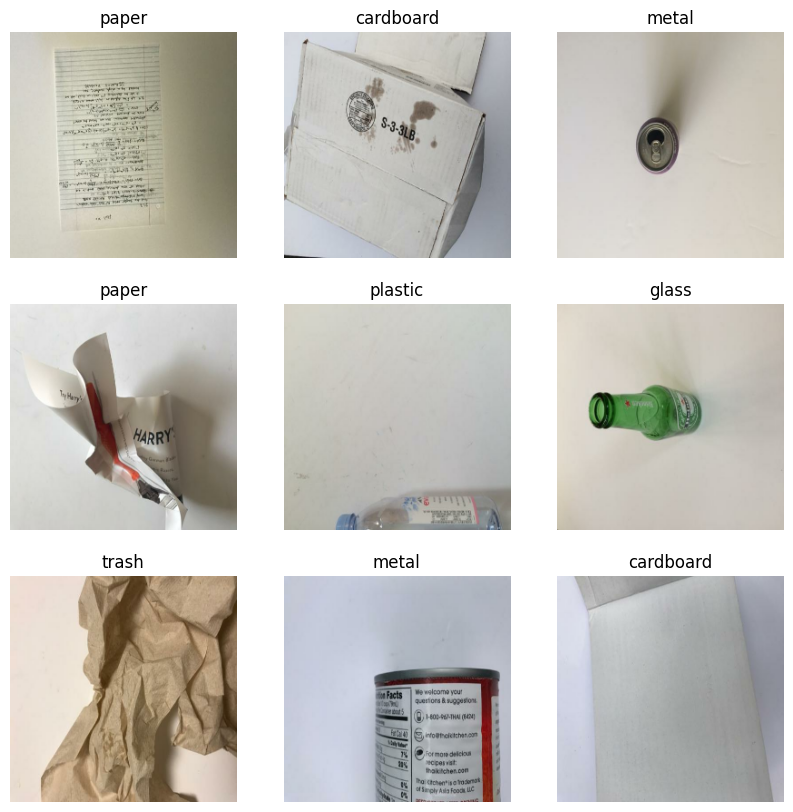

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [ ]:
# Configure the dataset for performance

AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)
test_ds = test_ds.cache().prefetch(buffer_size=AUTOTUNE)

#### Create a basic Keras model

In [ ]:
img_size =250

model = Sequential([
  layers.Rescaling(1./255, input_shape=(img_size, img_size, 3)), # Normalize the input data
  layers.Conv2D(32,(3,3), padding='same',activation='relu'),
  layers.MaxPooling2D((2,2)),
  layers.Conv2D(64, (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D((2,2)),
  layers.Conv2D(128, (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D((2,2)),
  layers.Flatten(),
  layers.Dense(512, activation='relu'),
  layers.Dense(num_classes, activation='softmax')
])

model.compile(optimizer=optimizers.RMSprop(learning_rate=1e-5),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs= 20
)

Epoch 1/20
56/56 [==============================] - 20s 160ms/step - loss: 1.6780 - accuracy: 0.2708 - val_loss: 1.6252 - val_accuracy: 0.3743
Epoch 2/20
56/56 [==============================] - 4s 71ms/step - loss: 1.5659 - accuracy: 0.3804 - val_loss: 1.5313 - val_accuracy: 0.4251
Epoch 3/20
56/56 [==============================] - 4s 71ms/step - loss: 1.4769 - accuracy: 0.4381 - val_loss: 1.4745 - val_accuracy: 0.4332
Epoch 4/20
56/56 [==============================] - 4s 75ms/step - loss: 1.4118 - accuracy: 0.4647 - val_loss: 1.4198 - val_accuracy: 0.4652
Epoch 5/20
56/56 [==============================] - 4s 72ms/step - loss: 1.3655 - accuracy: 0.4765 - val_loss: 1.3832 - val_accuracy: 0.4679
Epoch 6/20
56/56 [==============================] - 4s 71ms/step - loss: 1.3281 - accuracy: 0.4845 - val_loss: 1.3610 - val_accuracy: 0.4840
Epoch 7/20
56/56 [==============================] - 4s 74ms/step - loss: 1.2988 - accuracy: 0.5093 - val_loss: 1.3528 - val_accuracy: 0.4893
Epoch 8/20


3. Report the model performance against the success criteria that you define.

In [ ]:
test_loss, test_acc = model.evaluate(test_ds)
print("Accuracy", test_acc)

12/12 [==============================] - 1s 118ms/step - loss: 1.1966 - accuracy: 0.5625
Accuracy 0.5625


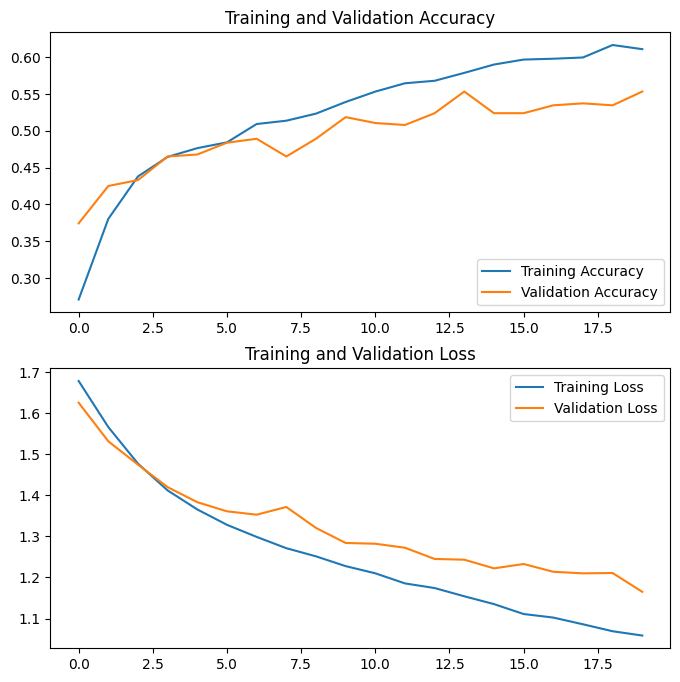

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(20)

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

The training accuracy increases rapidly initially and then gradually approaches a high value around 0.6, indicating that the model is able to fit the training data at some points but not optimal.
The gap between the training and validation accuracy curves suggests that the model is not overfitting and can generalize effectively to unseen data.

For the loss plot, the fluctuations in the validation loss curve could indicate instability during the training process, which may be addressed by adjusting the learning rate, or optimization algorithm.

- Predict the class for testing images and plot the confusion matrix

In [ ]:
class_pred = model.predict(test_ds)
class_pred = np.argmax(class_pred, axis=1)
class_true = np.concatenate([y for x, y in test_ds], axis=0)

12/12 [==============================] - 0s 24ms/step


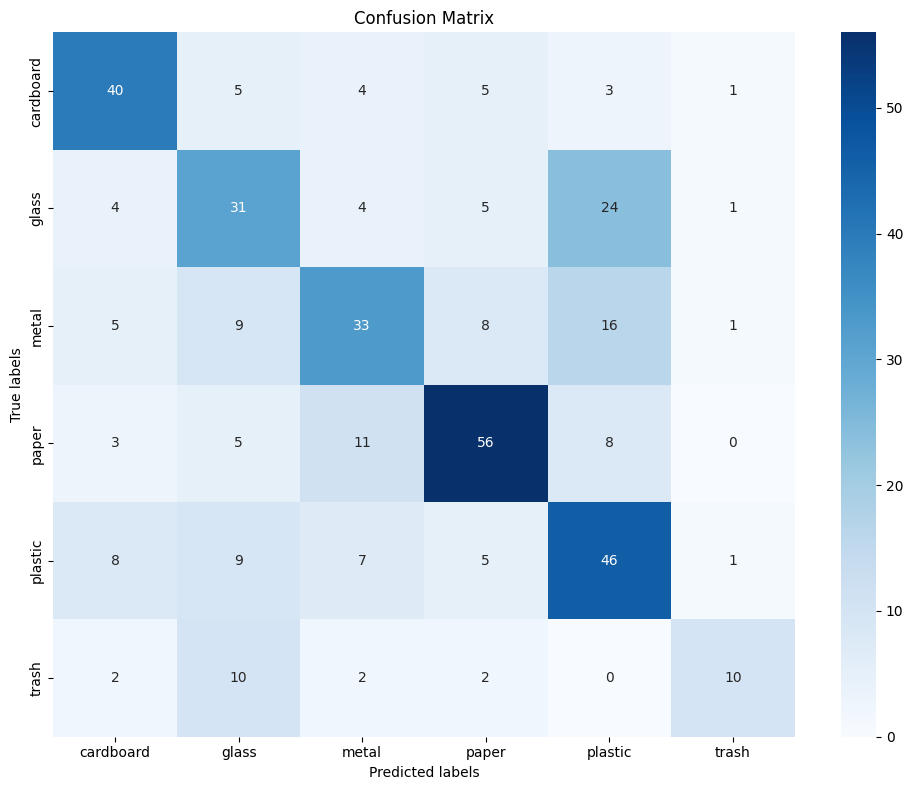

Recall for class cardboard: 0.6896551724137931
Recall for class glass: 0.4492753623188406
Recall for class metal: 0.4583333333333333
Recall for class paper: 0.6746987951807228
Recall for class plastic: 0.6052631578947368
Recall for class trash: 0.38461538461538464


In [ ]:
import seaborn as sns
from sklearn.metrics import confusion_matrix, precision_score, recall_score

# Create the confusion matrix
cm = confusion_matrix(class_true, class_pred)

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=class_names, yticklabels=class_names)

# Set labels and title
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')

# Adjust the layout
plt.tight_layout()

# Display the plot
plt.show()

recall_scores = recall_score(class_true, class_pred, average=None)

# Print precision scores for each class
for i, score in enumerate(recall_scores):
    print(f"Recall for class {class_names[i]}: {score}")

From the confusion matrix, we found that the model performs well when diffrentiate the images of cardboard, glass, and paper, but at the same time, it frequently missclassify the plastic as glass.

In this case, we will focus on recall because the aim of the model is to reduce recycling contamination. Recall measures the proportion of actual recyclable items that are correctly classified by the system. High recall means that the system successfully identifies most of the recyclable items, ensuring they are directed to the proper recycling stream. If recyclable items are incorrectly classified as non-recyclable, they can be mistakenly discarded, reducing the efficiency and effectiveness of the recycling process.

If the system has high recall, it means that most of the actual recyclable items are correctly identified and processed. Conversely, if the system has low recall, many recyclable items might be misclassified as non-recyclable, leading to missed opportunities for recycling and increased waste.

Because we want to ensure that most of the actual "trash" items are identified so they can not contaminate the recyle process, so the recall of trash in this model still low and the model needs to improve.

## **Task 2  Analyse and improve the model**

### Task 2.1 Build an input pipeline for data augmentation



- Report the model performance with the pipeline added. How much performance gain have you achieved?    



In [ ]:
pip install -U tensorboard-plugin-profile

In [ ]:
data_augmentation = tf.keras.Sequential(
  [
    layers.RandomFlip("horizontal_and_vertical"),
    layers.RandomContrast(0.4),
    layers.RandomRotation(0.2),
    layers.RandomZoom(0.2),
  ]
)

In [ ]:
model_2 = Sequential([
  layers.Rescaling(1./255, input_shape=(img_size, img_size, 3)),
  data_augmentation,
  layers.Conv2D(32,(3,3), padding='same',activation='relu'),
  layers.MaxPooling2D((2,2)),
  layers.Conv2D(64, (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D((2,2)),
  layers.Conv2D(128, (3,3), padding='same', activation='relu'),
  layers.MaxPooling2D((2,2)),
  layers.Flatten(),
  layers.Dense(512, activation='relu'),
  layers.Dense(num_classes, activation='softmax')
])

model_2.compile(optimizer=optimizers.RMSprop(learning_rate=1e-5),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

logs = "logs/"
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logs,
                                                      profile_batch = '500,520')
tf.profiler.experimental.stop()

history = model_2.fit(
  train_ds,
  validation_data=val_ds,
  epochs= 20,
  callbacks=[tensorboard_callback]
)

Epoch 1/20
56/56 [==============================] - 6s 86ms/step - loss: 1.6981 - accuracy: 0.2606 - val_loss: 1.6415 - val_accuracy: 0.3235
Epoch 2/20
56/56 [==============================] - 4s 80ms/step - loss: 1.6159 - accuracy: 0.3539 - val_loss: 1.6035 - val_accuracy: 0.3583
Epoch 3/20
56/56 [==============================] - 5s 83ms/step - loss: 1.5532 - accuracy: 0.3838 - val_loss: 1.5381 - val_accuracy: 0.3636
Epoch 4/20
56/56 [==============================] - 5s 82ms/step - loss: 1.5085 - accuracy: 0.4110 - val_loss: 1.4935 - val_accuracy: 0.4011
Epoch 5/20
56/56 [==============================] - 4s 80ms/step - loss: 1.4715 - accuracy: 0.4087 - val_loss: 1.4944 - val_accuracy: 0.4305
Epoch 6/20
56/56 [==============================] - 4s 80ms/step - loss: 1.4613 - accuracy: 0.4132 - val_loss: 1.4745 - val_accuracy: 0.4358
Epoch 7/20
56/56 [==============================] - 5s 82ms/step - loss: 1.4485 - accuracy: 0.4251 - val_loss: 1.4336 - val_accuracy: 0.4439
Epoch 8/20
56

- Report model performance

In [ ]:
test_loss, test_acc = model_2.evaluate(test_ds)
print("Accuracy", test_acc)

12/12 [==============================] - 0s 22ms/step - loss: 1.4468 - accuracy: 0.4115
Accuracy 0.4114583432674408


In [ ]:
class_pred = model_2.predict(test_ds)
class_pred = np.argmax(class_pred, axis=1)
class_true = np.concatenate([y for x, y in test_ds], axis=0)

12/12 [==============================] - 0s 20ms/step


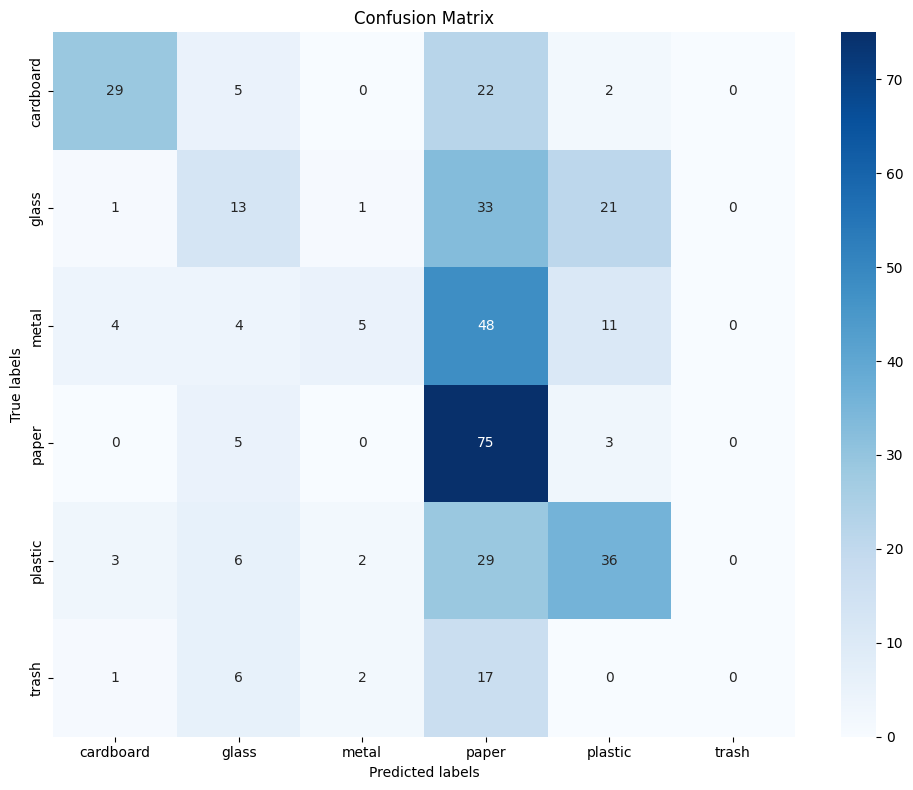

Recall for class cardboard: 0.5
Recall for class glass: 0.18840579710144928
Recall for class metal: 0.06944444444444445
Recall for class paper: 0.9036144578313253
Recall for class plastic: 0.47368421052631576
Recall for class trash: 0.0


In [ ]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Create the confusion matrix
cm = confusion_matrix(class_true, class_pred)

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=class_names, yticklabels=class_names)

# Set labels and title
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')

# Adjust the layout
plt.tight_layout()

# Display the plot
plt.show()

recall_scores = recall_score(class_true, class_pred, average=None)

# Print precision scores for each class
for i, score in enumerate(recall_scores):
    print(f"Recall for class {class_names[i]}: {score}")

The model's performance did not improve after data augmentation; in fact, it performed worse. This result can be attributed to several factors: the augmentations may be unsuitable for the data, or the model might be either too simple or too complex for the task.

- Profile your input pipeline to identify the most time-consuming operation: the profile of input pipeline can be observed via the Profile tab in TensorBoard

By reading the Profile, we could know that most running time is waiting for input, so we need to reduce the input time mostly.

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
%tensorboard --logdir=logs

<IPython.core.display.Javascript object>

![Profile tab](https://drive.google.com/uc?export=view&id=1ThaWVIejVVQV0Aq6lGD6IoPGV7wM_y8Z)

### Task 2.2 Compare the performance under equal training time

You may notice that with your pipeline, the model performance improves, but at the cost of a longer training time per epoch. Is the additional training time well spent? Compare the dynamic of model performance (e.g., classification accuracy on the test data) with and without data augmentation, when equal training time is spent in the two scenarios.

Epoch 1/20
56/56 [==============================] - 5s 83ms/step - loss: 1.0364 - accuracy: 0.6343 - val_loss: 1.2185 - val_accuracy: 0.5401
Epoch 2/20
56/56 [==============================] - 5s 84ms/step - loss: 1.0262 - accuracy: 0.6382 - val_loss: 1.1600 - val_accuracy: 0.5642
Epoch 3/20
56/56 [==============================] - 5s 90ms/step - loss: 1.0130 - accuracy: 0.6410 - val_loss: 1.1654 - val_accuracy: 0.5615
Epoch 4/20
56/56 [==============================] - 5s 88ms/step - loss: 0.9950 - accuracy: 0.6456 - val_loss: 1.1592 - val_accuracy: 0.5588
Epoch 5/20
56/56 [==============================] - 5s 84ms/step - loss: 0.9824 - accuracy: 0.6574 - val_loss: 1.1527 - val_accuracy: 0.5802
Epoch 6/20
56/56 [==============================] - 5s 91ms/step - loss: 0.9649 - accuracy: 0.6761 - val_loss: 1.1610 - val_accuracy: 0.5348
Epoch 7/20
56/56 [==============================] - 5s 82ms/step - loss: 0.9425 - accuracy: 0.6699 - val_loss: 1.1107 - val_accuracy: 0.5882
Epoch 8/20
56

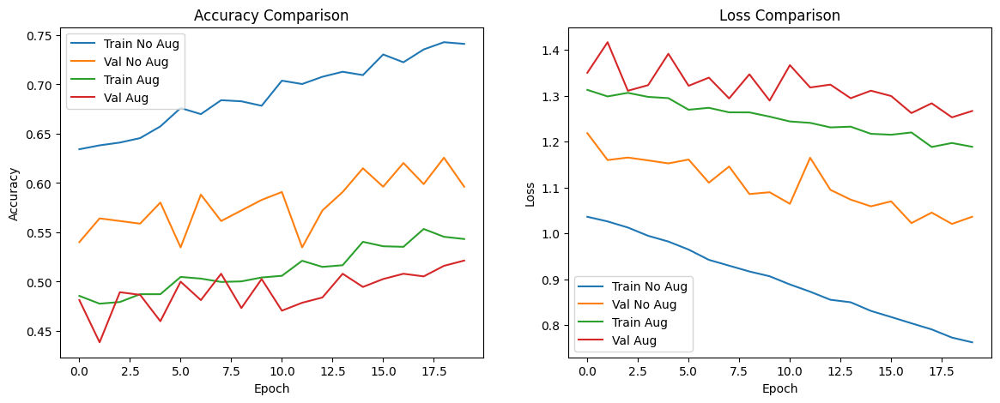

12/12 [==============================] - 0s 25ms/step - loss: 1.3048 - accuracy: 0.5391
Test Accuracy without Augmentation: 0.5989583134651184
Test Accuracy with Augmentation: 0.5390625


In [ ]:
import time

# Training without data augmentation

start_time = time.time()
history_no_aug = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=20,
)
training_time_no_aug = time.time() - start_time

# Training with data augmentation

start_time = time.time()
history_aug = model_2.fit(
    train_ds,
    validation_data=val_ds,
    epochs=20,
)
training_time_aug = time.time() - start_time

# Ensuring equal training time
epochs_no_aug = int(20 * (training_time_no_aug / training_time_aug))
epochs_aug = 20

# Plot accuracy and loss for comparison
plt.figure(figsize=(14, 5))

# Accuracy comparison
plt.subplot(1, 2, 1)
plt.plot(history_no_aug.history['accuracy'], label='Train No Aug')
plt.plot(history_no_aug.history['val_accuracy'], label='Val No Aug')
plt.plot(history_aug.history['accuracy'], label='Train Aug')
plt.plot(history_aug.history['val_accuracy'], label='Val Aug')
plt.title('Accuracy Comparison')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Loss comparison
plt.subplot(1, 2, 2)
plt.plot(history_no_aug.history['loss'], label='Train No Aug')
plt.plot(history_no_aug.history['val_loss'], label='Val No Aug')
plt.plot(history_aug.history['loss'], label='Train Aug')
plt.plot(history_aug.history['val_loss'], label='Val Aug')
plt.title('Loss Comparison')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.show()

# Final test accuracy comparison

test_loss_no_aug, test_acc_no_aug = model.evaluate(test_ds)
test_loss_aug, test_acc_aug = model_2.evaluate(test_ds)

print(f'Test Accuracy without Augmentation: {test_acc_no_aug}')
print(f'Test Accuracy with Augmentation: {test_acc_aug}')


When equal training time is spent, the model without data augmentation still perform better.

### Task 2.3 Identifying model strengths and weaknesses

Identify images that are incorrectly classified by your model. Do they share something in common? How do you plan to improve the model's performance on those images?

From these two confusion matrices, we found that trash images are often misclassified as glass or other items. Additionally, predictions tend to predict incorrectly between glass and plastic, as well as glass and metal. To address these issues, we plan to enhance the model's performance through techniques like transfer learning after trying data augmentation. By leveraging transfer learning, we aim to benefit from existing knowledge to improve the model's ability to distinguish between classes and reduce misclassifications.


After researching other papers [2], [3], [4] that utilize the TrashNet dataset, we believe that employing a pre-trained model and adding additional layers would enhance prediction accuracy. Therefore, we have decided to utilize VGG16 as the base model and augment it with additional layers to improve the overall performance of the model.

In [ ]:
from tensorflow.keras.applications import VGG16

conv_base = VGG16(weights='imagenet',
                  include_top=False,
                  input_shape=(250, 250, 3))

conv_base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 250, 250, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 250, 250, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 250, 250, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 125, 125, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 125, 125, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 125, 125, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 62, 62, 128)       0     

In [ ]:
conv_base.trainable = False

model_3 = Sequential([
  layers.Rescaling(1./255, input_shape=(img_size, img_size, 3)),
  conv_base,
  layers.Flatten(),
  layers.Dense(512, activation='relu'),
  layers.Dense(num_classes,activation='softmax'),
])

model_3.compile(optimizer=optimizers.RMSprop(learning_rate=1e-5),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy'])

epochs=20

history = model_3.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/20
56/56 [==============================] - 32s 419ms/step - loss: 1.4665 - accuracy: 0.4392 - val_loss: 1.2975 - val_accuracy: 0.5187
Epoch 2/20
56/56 [==============================] - 11s 202ms/step - loss: 1.1075 - accuracy: 0.6303 - val_loss: 1.1296 - val_accuracy: 0.5695
Epoch 3/20
56/56 [==============================] - 12s 209ms/step - loss: 0.9255 - accuracy: 0.6942 - val_loss: 1.1121 - val_accuracy: 0.5802
Epoch 4/20
56/56 [==============================] - 12s 214ms/step - loss: 0.8051 - accuracy: 0.7434 - val_loss: 0.9842 - val_accuracy: 0.6283
Epoch 5/20
56/56 [==============================] - 11s 203ms/step - loss: 0.7102 - accuracy: 0.7801 - val_loss: 0.9354 - val_accuracy: 0.6738
Epoch 6/20
56/56 [==============================] - 12s 207ms/step - loss: 0.6367 - accuracy: 0.8118 - val_loss: 0.9086 - val_accuracy: 0.6952
Epoch 7/20
56/56 [==============================] - 11s 203ms/step - loss: 0.5743 - accuracy: 0.8389 - val_loss: 0.8484 - val_accuracy: 0.7193

- Report model performance

In [ ]:
test_loss, test_acc = model_3.evaluate(test_ds)
print("Accuracy", test_acc)

12/12 [==============================] - 2s 172ms/step - loss: 0.8003 - accuracy: 0.7266
Accuracy 0.7265625


In [ ]:
class_pred = model_3.predict(test_ds)
class_pred = np.argmax(class_pred, axis=1)

12/12 [==============================] - 2s 167ms/step


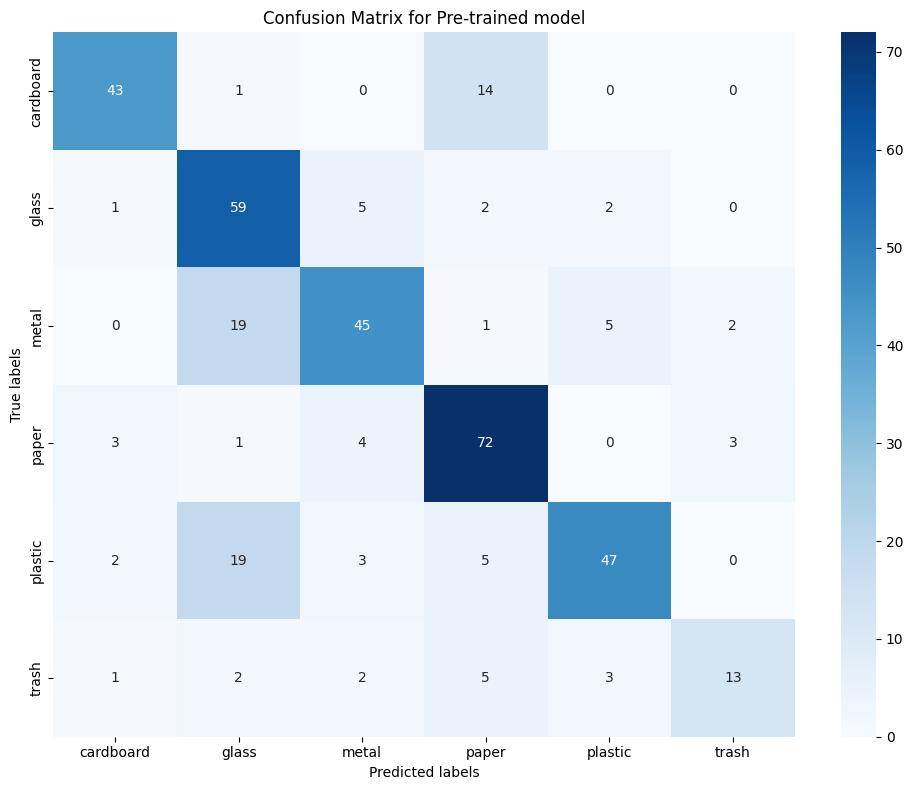

Recall for class cardboard: 0.7413793103448276
Recall for class glass: 0.855072463768116
Recall for class metal: 0.625
Recall for class paper: 0.8674698795180723
Recall for class plastic: 0.618421052631579
Recall for class trash: 0.5


In [ ]:
# Create the confusion matrix
cm = confusion_matrix(class_true, class_pred)

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g', xticklabels=class_names, yticklabels=class_names)

# Set labels and title
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix for Pre-trained model')

# Adjust the layout
plt.tight_layout()

# Display the plot
plt.show()

recall_scores = recall_score(class_true, class_pred, average=None)

# Print precision scores for each class
for i, score in enumerate(recall_scores):
    print(f"Recall for class {class_names[i]}: {score}")

The latest model show superior performance and considered to be the most promising among the three models we developed. With a test accuracy exceeding 70%, it demonstrates a strong ability to classify images accurately. The confusion matrix reveals the model's proficiency in correctly identifying true classes. However, it's noteworthy that the recall for the trash class is approximately 0.5, indicating that the model captures only 50% of actual trash instances. This limitation could came from insufficient training data for the trash class, impacting the model's ability to learn representative features effectively.

## **Task 3. Improve model generalisability across domains**


1. Some sample images from the original test data

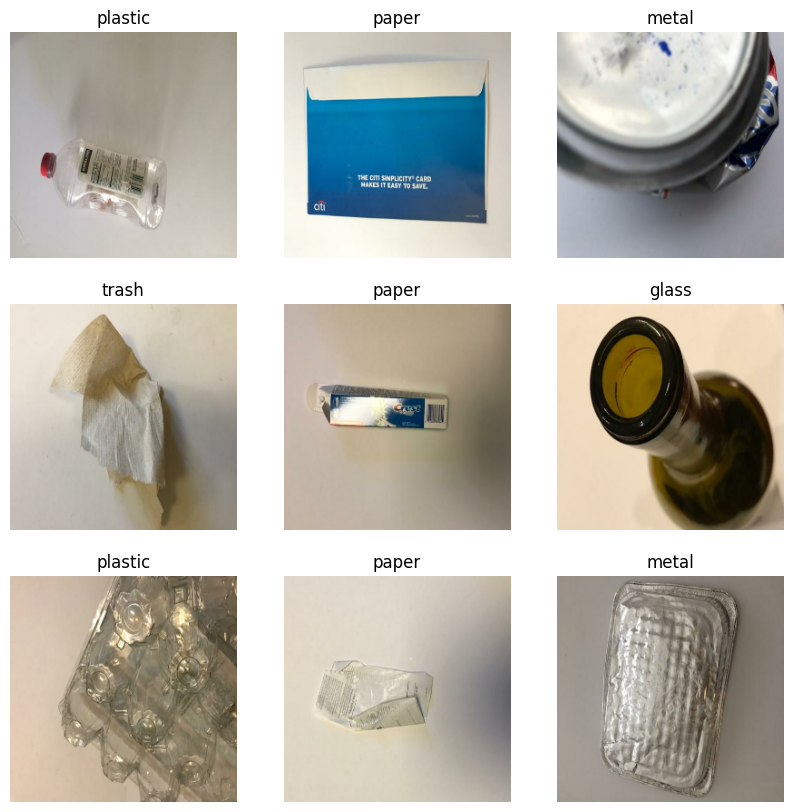

In [ ]:
plt.figure(figsize=(10, 10))
for images, labels in test_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

For the new test data, we have take some photos by Iphone and upload it via the website. These images will be shown later when the model completed predicting process. But some of the new images have different background color with previous test data (which has white background color)

- Feed the new test data into the model, and Report the performance change.

1/1 [==============================] - 1s 1s/step
Image 1 most likely belongs to metal with a 24.70% confidence.


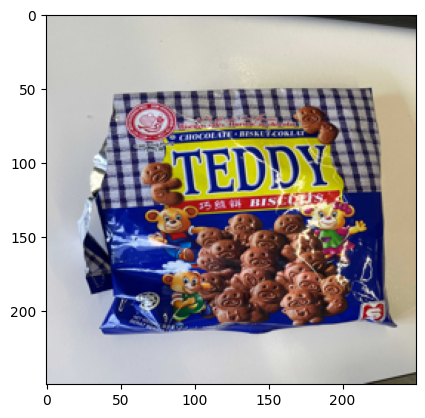

1/1 [==============================] - 0s 30ms/step
Image 2 most likely belongs to glass with a 24.67% confidence.


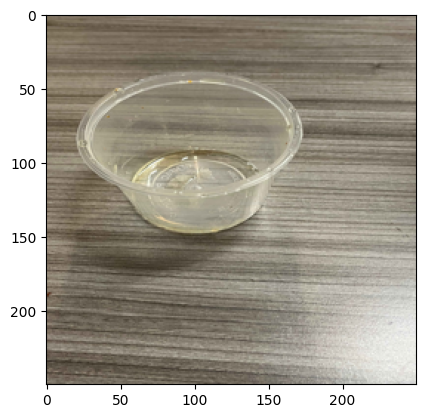

1/1 [==============================] - 0s 35ms/step
Image 3 most likely belongs to metal with a 32.97% confidence.


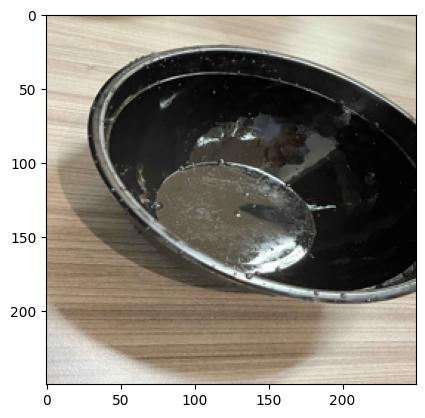

1/1 [==============================] - 0s 27ms/step
Image 4 most likely belongs to paper with a 25.49% confidence.


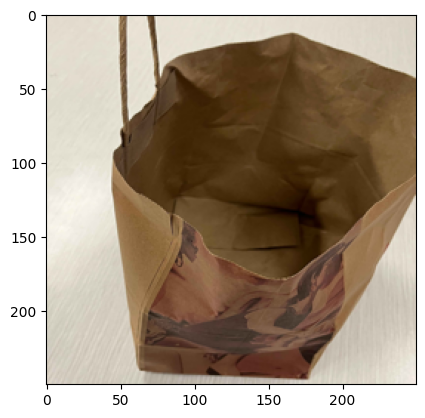

1/1 [==============================] - 0s 28ms/step
Image 5 most likely belongs to metal with a 28.36% confidence.


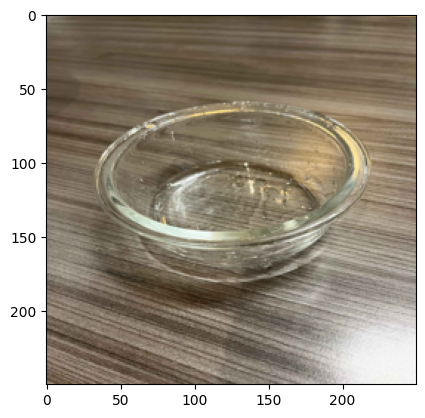

1/1 [==============================] - 0s 32ms/step
Image 6 most likely belongs to cardboard with a 28.10% confidence.


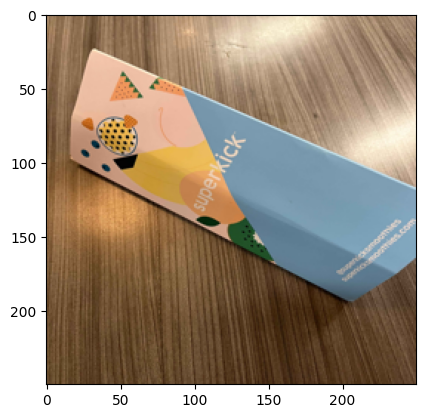

1/1 [==============================] - 0s 41ms/step
Image 7 most likely belongs to cardboard with a 23.08% confidence.


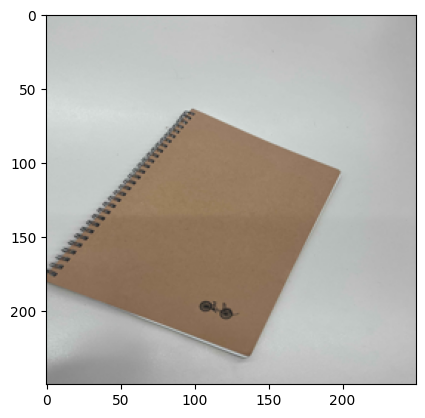

In [ ]:
from PIL import Image

# Define image URLs
image_urls = [
    'https://i.ibb.co/dMnm4g1/test1-1.jpg',
    'https://i.ibb.co/Hg9sN2n/test-2.jpg',
    'https://i.ibb.co/DzN8M5N/test-3.jpg',
    'https://i.ibb.co/hY9LXMY/test-4.jpg',
    'https://i.ibb.co/9vjM8FM/test-5.jpg',
    'https://i.ibb.co/hdBmcy1/test-6.jpg',
    'https://i.ibb.co/TcmBfLB/test-7.jpg'
]

# Load and preprocess images
images = []
for url in image_urls:
    response = requests.get(url, stream=True)
    image = Image.open(io.BytesIO(response.content)).resize((img_size, img_size))
    images.append(image)

# Convert images to arrays
img_arrays = [tf.keras.preprocessing.image.img_to_array(img) for img in images]

# Make predictions for each image
for i, img_array in enumerate(img_arrays, start=1):
    img_array = tf.expand_dims(img_array, 0)  # Create a batch
    predictions = model_3.predict(img_array)
    score = tf.nn.softmax(predictions[0])
    print("Image {} most likely belongs to {} with a {:.2f}% confidence."
          .format(i, class_names[np.argmax(score)], 100 * np.max(score)))
    plt.imshow(images[i - 1])  # Plot the original image
    plt.show()  # Show the image



With the new test image, the model correctly predicted only 3 out of 7 images. This outcome may be attributed to similarities between certain images. For instance, image 2 closely resembles glass due to its color.

Refences:

1. Aral, RA, Keskin, SR, Kaya, M & Haciomeroglu, M 2018, ‘Classification of TrashNet Dataset Based on Deep Learning Models’, 2018 IEEE International Conference on Big Data (Big Data).
2. Ching, C 2019, ‘How to build an image classifier for waste sorting’, Medium, retrieved from <https://towardsdatascience.com/how-to-build-an-image-classifier-for-waste-sorting-6d11d3c9c478>.
3. He, Y, Gu, Q & Shi, M Trash Classification Using Convolutional Neural Networks Project Category: Computer Vision, retrieved May 20, 2024, from <https://cs230.stanford.edu/projects_spring_2020/reports/38847029.pdf>.
4. ‘Image classification | TensorFlow Core’ TensorFlow, retrieved May 20, 2024, from <https://www.tensorflow.org/tutorials/images/classification>.
5. Poudel, S & Poudyal, P 2022, ‘Classification of Waste Materials using CNN Based on Transfer Learning’, Proceedings of the 14th Annual Meeting of the Forum for Information Retrieval Evaluation.
6. Thung, G 2020, ‘garythung/trashnet’, GitHub, retrieved from <https://github.com/garythung/trashnet>.
7. Zhang, Q, Zhang, X, Mu, X, Wang, Z, Tian, R, Wang, X & Liu, X 2021, ‘Recyclable waste image recognition based on deep learning’, Resources, Conservation and Recycling, vol. 171, p. 105636.